# Satellite Images of Water Bodies

1. Dataset<br>
A collection of water bodies images captured by the Sentinel-2 Satellite. Each image comes with a black and white mask where white represents water and black represents something else but water.<br>
Data comes from Kaggle: https://www.kaggle.com/datasets/franciscoescobar/satellite-images-of-water-bodies

2. Project<br>
The goal of this project was to use a standard U-net implementation for image segmentation, more specifically, to train the network to recognize and locate bodies of water on the image.


In [3]:
import os
import numpy as np
from tqdm import tqdm
import cv2 as cv
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from keras import Model
from keras.callbacks import Callback
from keras.optimizers import Adam
from keras.utils import plot_model
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, Dropout

In [4]:
image_path = 'test/Water Bodies Dataset/Images/'
mask_path = 'test/Water Bodies Dataset/Masks/'
SIZE = 128

In [5]:
# lists of images and masks names
image_names = sorted(next(os.walk(image_path))[-1])
mask_names = sorted(next(os.walk(mask_path))[-1])

images = np.zeros(shape=(len(image_names),SIZE, SIZE, 3))
masks = np.zeros(shape=(len(image_names),SIZE, SIZE, 1))

for id in tqdm(range(len(image_names)), desc="Images"):
  path = image_path + image_names[id]
  img = np.asarray(Image.open(path)).astype('float')/255.
  img = cv.resize(img, (SIZE,SIZE), cv.INTER_AREA)
  images[id] = img

for id in tqdm(range(len(mask_names)), desc="Mask"):
  path = mask_path + mask_names[id]
  mask = np.asarray(Image.open(path)).astype('float')/255.
  mask = cv.resize(mask, (SIZE,SIZE), cv.INTER_AREA)
  masks[id] = mask[:,:,:1]

Mask: 100%|██████████| 2841/2841 [00:13<00:00, 214.64it/s]


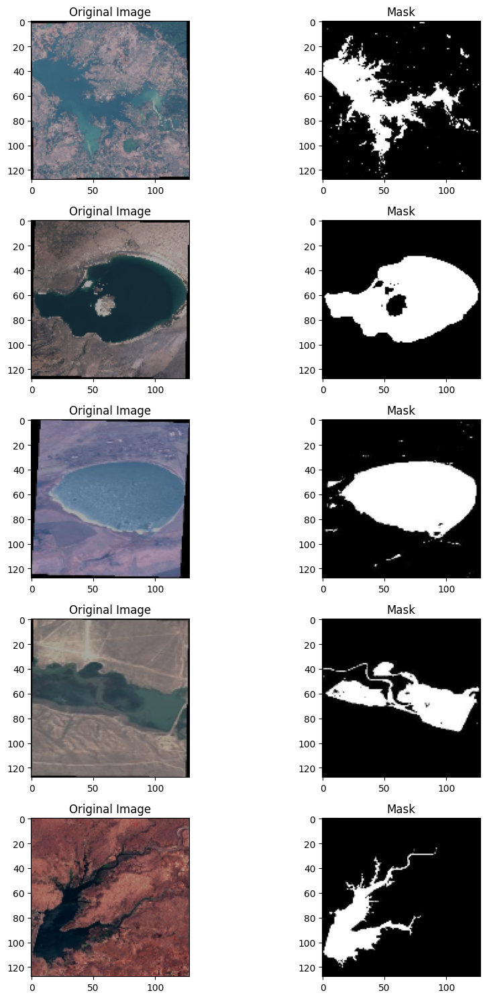

In [6]:
# Plot some images and its masks
plt.figure(figsize=(10,15))
for i in range(1,11):
  plt.subplot(5,2,i)

  if i%2!=0:
    id = np.random.randint(len(images))
    plt.imshow(images[id], cmap=None)
    plt.title('Original Image')
  elif i%2==0:
    plt.imshow(masks[id].reshape(128,128), cmap='gray')
    plt.title('Mask')

plt.tight_layout()
plt.show()

In [7]:
# Train test split
images_train, images_test, mask_train, mask_test = train_test_split(images, masks, test_size=0.01)

In [8]:
print(f'Train images: {len(images_train)}')
print(f'Test images: {len(images_test)}')

Train images: 2812
Test images: 29


In [9]:
# Define U-net architecture
def unet_model(input_layer, start_neurons):
    # Contraction path
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(input_layer)
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(conv1)
    pool1 = MaxPooling2D((2, 2))(conv1)
    pool1 = Dropout(0.25)(pool1)

    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(pool1)
    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(conv2)
    pool2 = MaxPooling2D((2, 2))(conv2)
    pool2 = Dropout(0.5)(pool2)

    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(pool2)
    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(conv3)
    pool3 = MaxPooling2D((2, 2))(conv3)
    pool3 = Dropout(0.5)(pool3)

    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(pool3)
    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(conv4)
    pool4 = MaxPooling2D((2, 2))(conv4)
    pool4 = Dropout(0.5)(pool4)

    # Middle
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(pool4)
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(convm)
    
    # Expansive path
    deconv4 = Conv2DTranspose(start_neurons*8, kernel_size=(3, 3), strides=(2, 2), padding="same")(convm)
    uconv4 = concatenate([deconv4, conv4])
    uconv4 = Dropout(0.5)(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)

    deconv3 = Conv2DTranspose(start_neurons*4, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv4)
    uconv3 = concatenate([deconv3, conv3])
    uconv3 = Dropout(0.5)(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)

    deconv2 = Conv2DTranspose(start_neurons*2, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv3)
    uconv2 = concatenate([deconv2, conv2])
    uconv2 = Dropout(0.5)(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)

    deconv1 = Conv2DTranspose(start_neurons*1, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv2)
    uconv1 = concatenate([deconv1, conv1])
    uconv1 = Dropout(0.5)(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    
    # Last conv and output
    output_layer = Conv2D(1, (1,1), padding="same", activation="sigmoid")(uconv1)
    
    return output_layer

In [10]:
# Compile unet model
input_layer = Input((SIZE, SIZE, 3))
output_layer = unet_model(input_layer = input_layer, start_neurons = 16)

model = Model(input_layer, output_layer)
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

I0000 00:00:1732244566.309120    3638 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9783 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:01:00.0, compute capability: 6.1


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │        448 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │      2,320 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 64, 64,    │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 64, 64,    │          0 │ max_pooling2d[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │      4,640 │ dropout[0][0]     │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │      9,248 │ conv2d_2[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 32, 32,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 32, 32,    │          0 │ max_pooling2d_1[… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 32, 32,    │     18,496 │ dropout_1[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 32, 32,    │     36,928 │ conv2d_4[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 16, 16,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 16, 16,    │          0 │ max_pooling2d_2[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 16, 16,    │     73,856 │ dropout_2[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 16, 16,    │    147,584 │ conv2d_6[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 8, 8, 128) │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 8, 8, 128) │          0 │ max_pooling2d_3[

 Total params: 2,158,705 (8.23 MB)

 Trainable params: 2,158,705 (8.23 MB)

 Non-trainable params: 0 (0.00 B)

In [11]:
# Post Process
def mask_threshold(image, threshold=0.25):
  return image>threshold

# Callback to show progress of learning on the images after each epoch
class ShowProgress(Callback):
  def __init__(self, save=False):
    self.save = save
  def on_epoch_end(self, epoch, logs=None):
    k = np.random.randint(len(images_train))
    original_image = images_train[k][np.newaxis,...]
    predicted_mask = self.model.predict(original_image).reshape(128,128)
    proc_mask02 = mask_threshold(predicted_mask, threshold=0.2)
    proc_mask03 = mask_threshold(predicted_mask, threshold=0.3)
    proc_mask04 = mask_threshold(predicted_mask, threshold=0.4)
    proc_mask05 = mask_threshold(predicted_mask, threshold=0.5)
    mask = mask_train[k].reshape(128,128)

    plt.figure(figsize=(15,10))

    plt.subplot(1,7,1)
    plt.imshow(original_image[0]);plt.title('Orginal Image')

    plt.subplot(1,7,2)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,7,3)
    plt.imshow(mask, cmap='gray');plt.title('Orginal Mask')

    plt.subplot(1,7,4)
    plt.imshow(proc_mask02, cmap='gray');plt.title('Processed: 0.2')

    plt.subplot(1,7,5)
    plt.imshow(proc_mask03, cmap='gray');plt.title('Processed: 0.3')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask04, cmap='gray');plt.title('Processed: 0.4')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask05, cmap='gray');plt.title('Processed: 0.5')

    plt.tight_layout()
    plt.show()

Epoch 1/100


I0000 00:00:1732244569.623228    5023 service.cc:148] XLA service 0x7f6b3800ec30 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1732244569.623461    5023 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce GTX 1080 Ti, Compute Capability 6.1
2024-11-21 19:02:49.704063: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1732244570.038448    5023 cuda_dnn.cc:529] Loaded cuDNN version 90300
2024-11-21 19:02:50.711540: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[32,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_con

 2/88 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.2953 - loss: 0.6996  

2024-11-21 19:02:57.926657: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion_4', 8 bytes spill stores, 8 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion', 8 bytes spill stores, 8 bytes spill loads

I0000 00:00:1732244577.955279    5023 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


86/88 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.5286 - loss: 0.6218

2024-11-21 19:03:01.726591: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[28,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[28,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2024-11-21 19:03:01.740599: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[28,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[28,16,128,128]{3,2,1,0}, f32[16,16,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationFor

88/88 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step - accuracy: 0.5294 - loss: 0.6208

2024-11-21 19:03:08.737594: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[29,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[29,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2024-11-21 19:03:08.745529: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[29,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[29,16,128,128]{3,2,1,0}, f32[16,16,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationFor

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 689ms/step


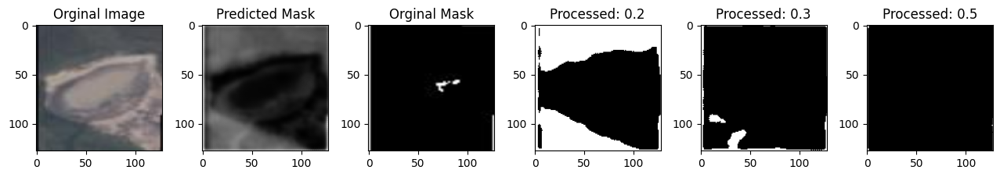

88/88 ━━━━━━━━━━━━━━━━━━━━ 23s 149ms/step - accuracy: 0.5298 - loss: 0.6204 - val_accuracy: 0.5851 - val_loss: 0.6502
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6327 - loss: 0.49


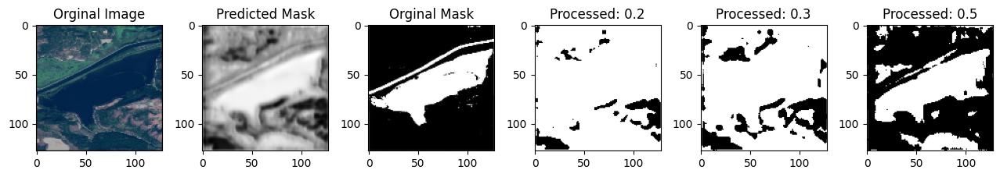

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.6327 - loss: 0.4908 - val_accuracy: 0.6161 - val_loss: 0.5964
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/stepep - accuracy: 0.6572 - loss: 0.455


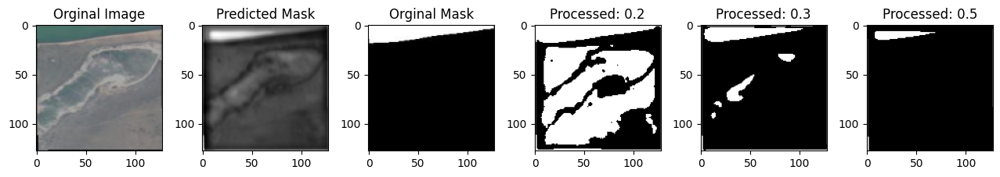

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.6571 - loss: 0.4551 - val_accuracy: 0.6165 - val_loss: 0.5906
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6669 - loss: 0.43


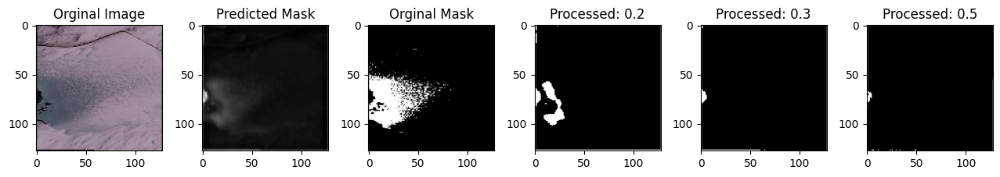

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.6669 - loss: 0.4378 - val_accuracy: 0.6257 - val_loss: 0.5360
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.6750 - loss: 0.40


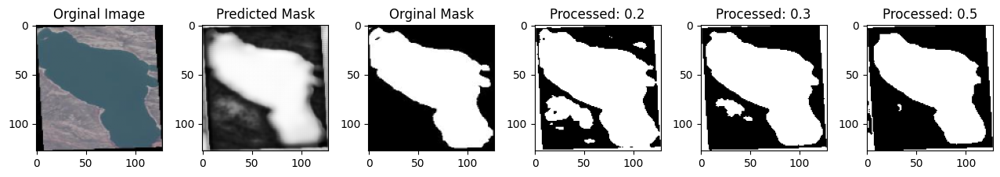

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.6751 - loss: 0.4054 - val_accuracy: 0.6530 - val_loss: 0.4818
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.6777 - loss: 0.42


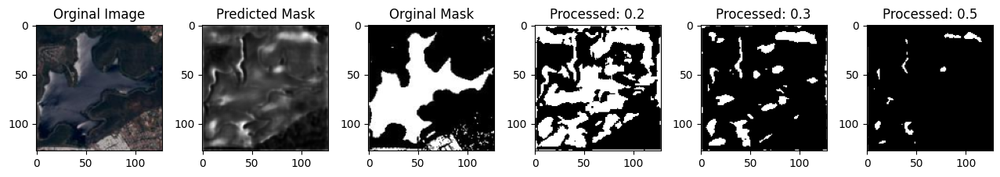

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.6777 - loss: 0.4221 - val_accuracy: 0.6474 - val_loss: 0.5578
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6853 - loss: 0.38


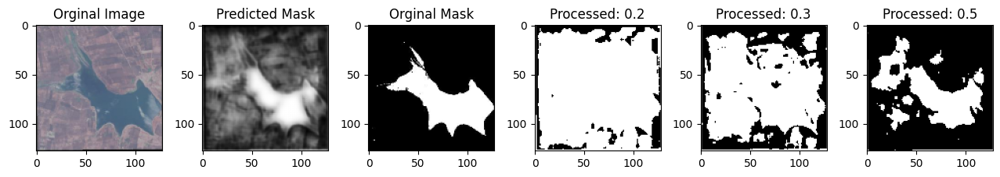

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.6853 - loss: 0.3887 - val_accuracy: 0.5974 - val_loss: 0.5206
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.6886 - loss: 0.37


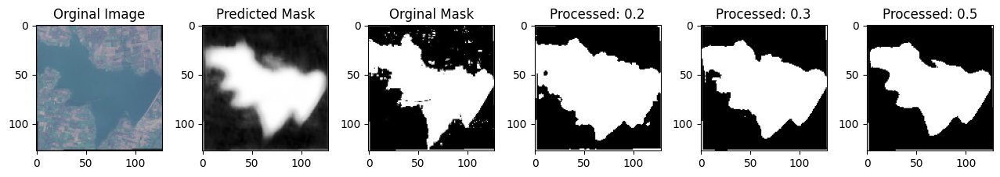

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.6887 - loss: 0.3753 - val_accuracy: 0.6677 - val_loss: 0.4212
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.6996 - loss: 0.34


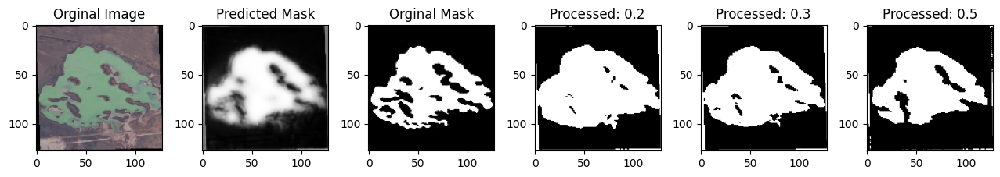

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.6996 - loss: 0.3465 - val_accuracy: 0.6784 - val_loss: 0.4084
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7111 - loss: 0.32


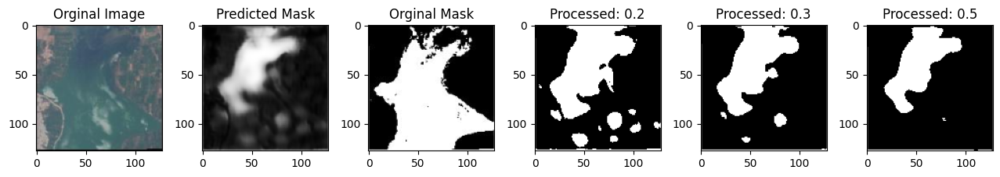

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7111 - loss: 0.3290 - val_accuracy: 0.6954 - val_loss: 0.3832
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7063 - loss: 0.33


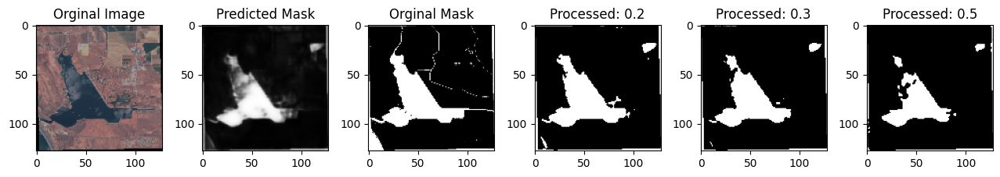

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7063 - loss: 0.3323 - val_accuracy: 0.6998 - val_loss: 0.3761
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7207 - loss: 0.30


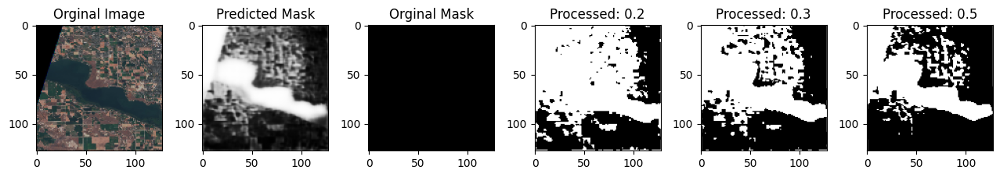

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7206 - loss: 0.3079 - val_accuracy: 0.7262 - val_loss: 0.3354
Epoch 13/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7113 - loss: 0.31


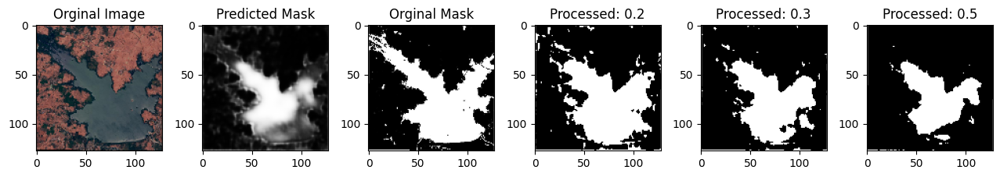

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7114 - loss: 0.3146 - val_accuracy: 0.6915 - val_loss: 0.4035
Epoch 14/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7102 - loss: 0.32


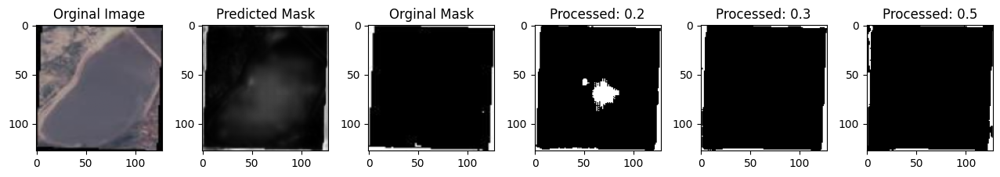

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7104 - loss: 0.3212 - val_accuracy: 0.7309 - val_loss: 0.3184
Epoch 15/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7129 - loss: 0.31


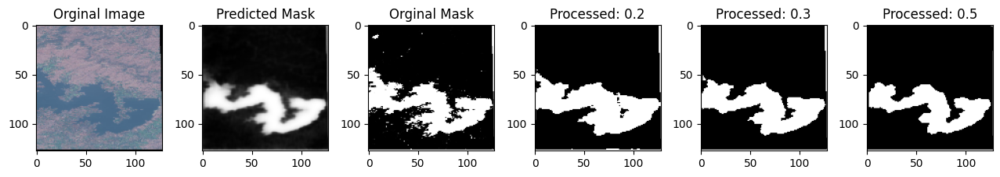

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7129 - loss: 0.3169 - val_accuracy: 0.7357 - val_loss: 0.3137
Epoch 16/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7151 - loss: 0.30


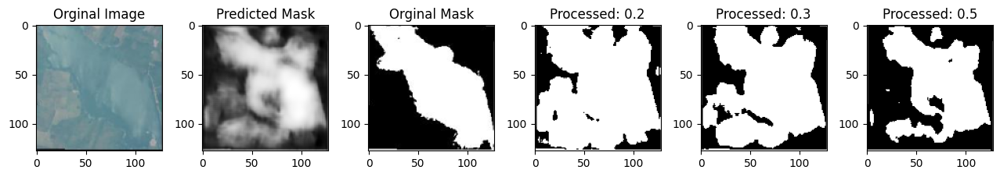

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7152 - loss: 0.3029 - val_accuracy: 0.7189 - val_loss: 0.3284
Epoch 17/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7187 - loss: 0.301


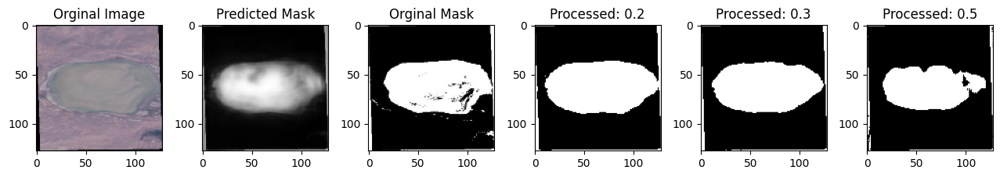

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7188 - loss: 0.3018 - val_accuracy: 0.7433 - val_loss: 0.2903
Epoch 18/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7248 - loss: 0.289


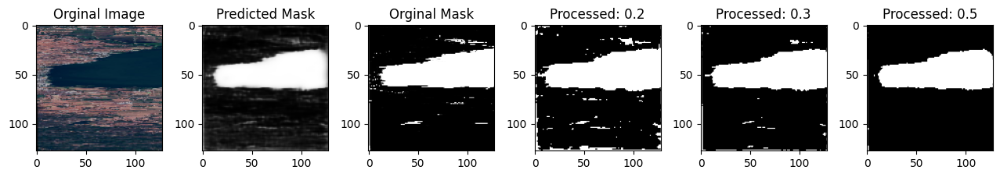

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7248 - loss: 0.2892 - val_accuracy: 0.7575 - val_loss: 0.2575
Epoch 19/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7307 - loss: 0.28


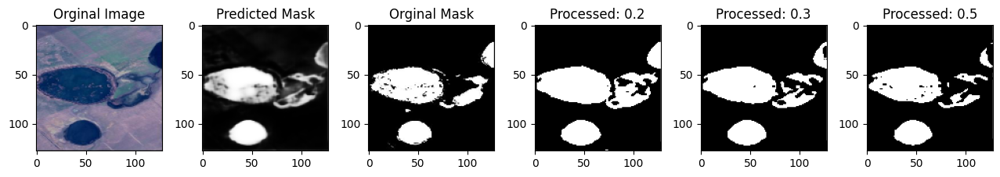

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7306 - loss: 0.2806 - val_accuracy: 0.7413 - val_loss: 0.2924
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7232 - loss: 0.29


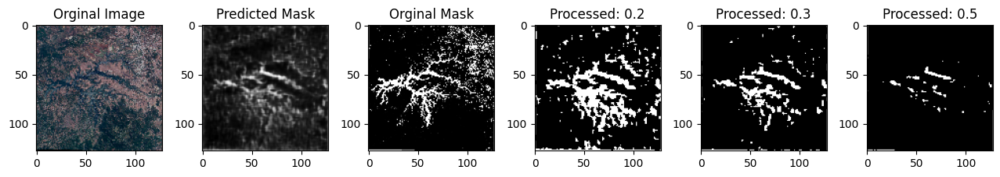

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7232 - loss: 0.2927 - val_accuracy: 0.7470 - val_loss: 0.2805
Epoch 21/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7249 - loss: 0.28


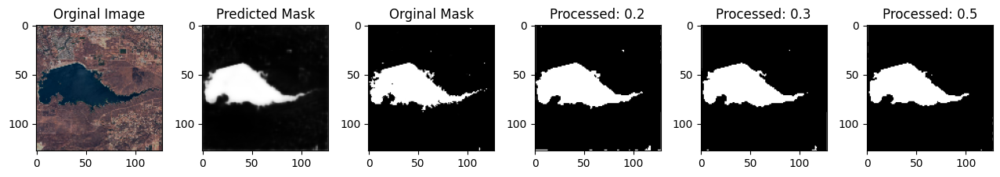

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7249 - loss: 0.2874 - val_accuracy: 0.7484 - val_loss: 0.2574
Epoch 22/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7303 - loss: 0.27


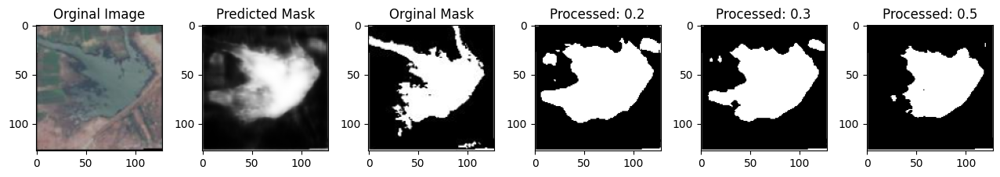

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7302 - loss: 0.2773 - val_accuracy: 0.7539 - val_loss: 0.2450
Epoch 23/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7278 - loss: 0.27


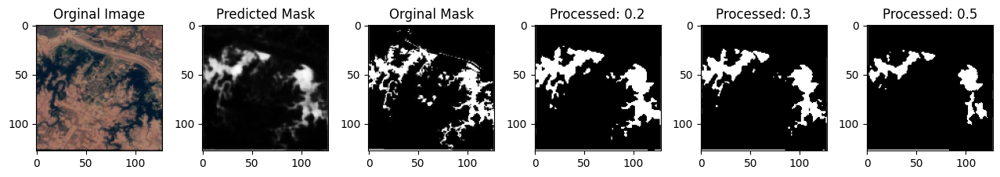

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7279 - loss: 0.2740 - val_accuracy: 0.7552 - val_loss: 0.2521
Epoch 24/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7317 - loss: 0.27


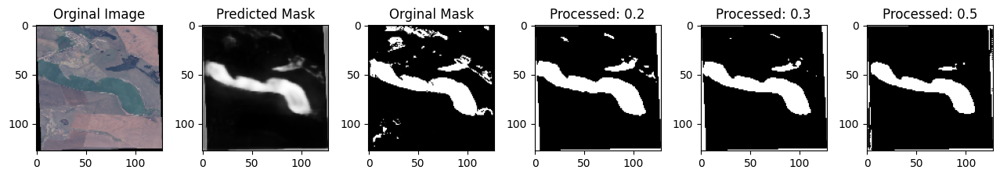

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7317 - loss: 0.2717 - val_accuracy: 0.7496 - val_loss: 0.2594
Epoch 25/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7368 - loss: 0.25


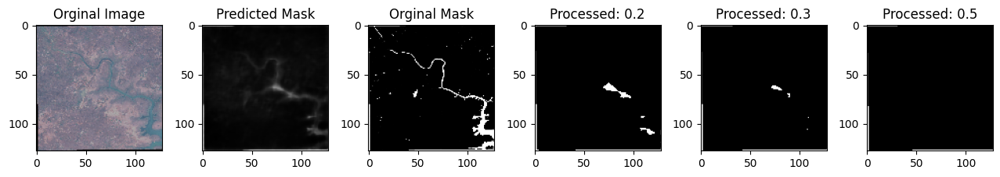

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7367 - loss: 0.2560 - val_accuracy: 0.7436 - val_loss: 0.2760
Epoch 26/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7326 - loss: 0.26


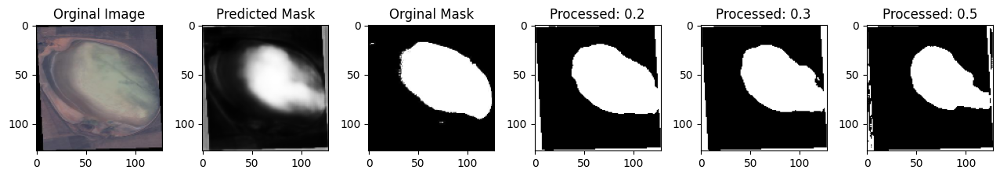

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7326 - loss: 0.2657 - val_accuracy: 0.7353 - val_loss: 0.2863
Epoch 27/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7300 - loss: 0.26


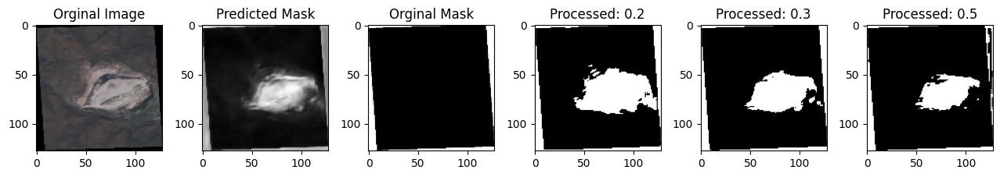

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7300 - loss: 0.2667 - val_accuracy: 0.7646 - val_loss: 0.2223
Epoch 28/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7304 - loss: 0.265


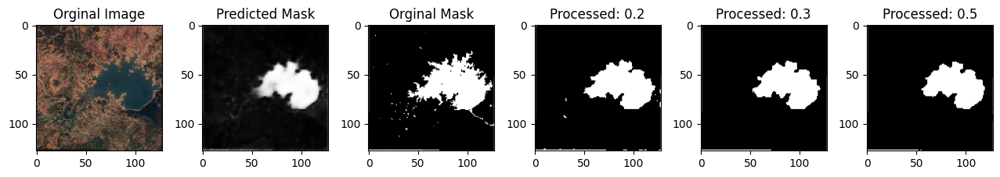

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7305 - loss: 0.2651 - val_accuracy: 0.7575 - val_loss: 0.2362
Epoch 29/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7299 - loss: 0.26


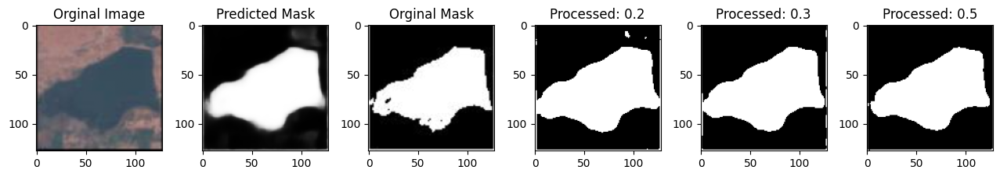

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7299 - loss: 0.2618 - val_accuracy: 0.7597 - val_loss: 0.2216
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7374 - loss: 0.24


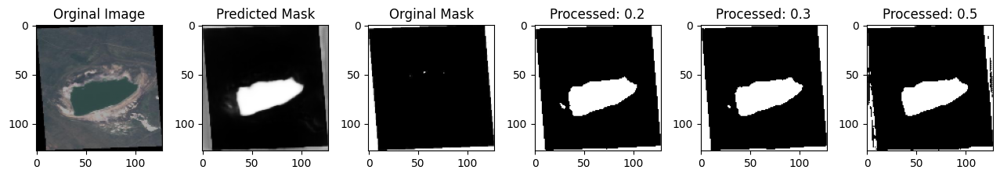

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7373 - loss: 0.2499 - val_accuracy: 0.7612 - val_loss: 0.2255
Epoch 31/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7332 - loss: 0.25


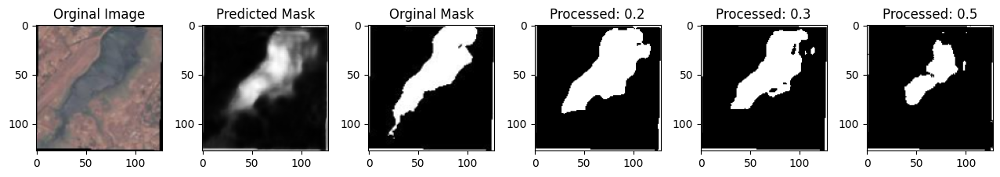

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7332 - loss: 0.2575 - val_accuracy: 0.7660 - val_loss: 0.2178
Epoch 32/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7435 - loss: 0.24


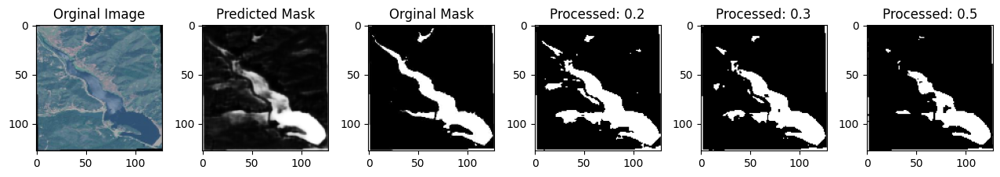

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7432 - loss: 0.2467 - val_accuracy: 0.7629 - val_loss: 0.2148
Epoch 33/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7363 - loss: 0.24


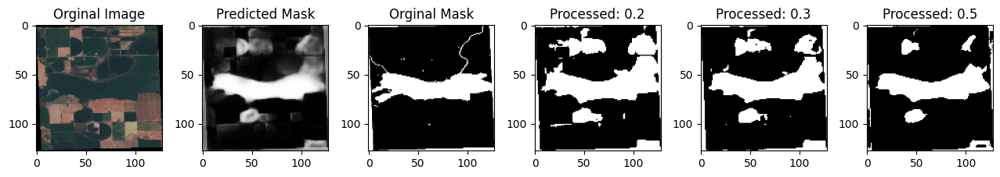

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7363 - loss: 0.2450 - val_accuracy: 0.7613 - val_loss: 0.2344
Epoch 34/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7429 - loss: 0.24


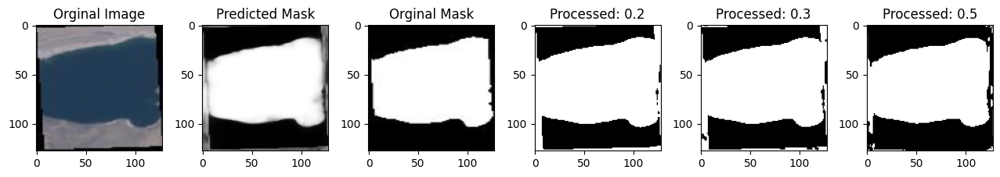

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7429 - loss: 0.2476 - val_accuracy: 0.7599 - val_loss: 0.2357
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7337 - loss: 0.25


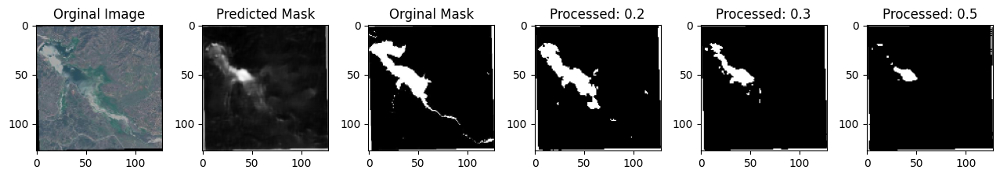

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7337 - loss: 0.2546 - val_accuracy: 0.7655 - val_loss: 0.2170
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7417 - loss: 0.23


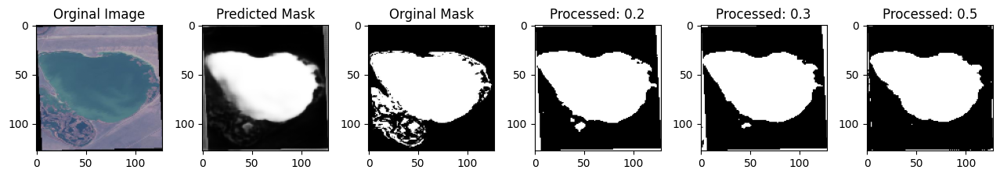

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7416 - loss: 0.2384 - val_accuracy: 0.7437 - val_loss: 0.2649
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7360 - loss: 0.24


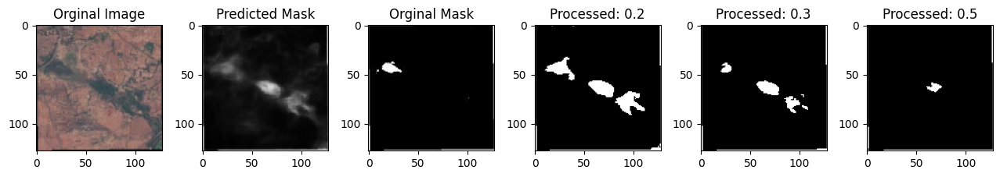

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7360 - loss: 0.2498 - val_accuracy: 0.7657 - val_loss: 0.2118
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7345 - loss: 0.25


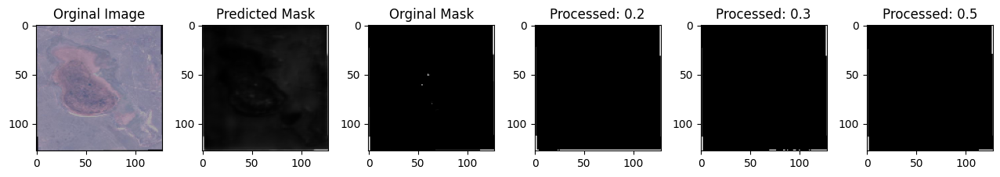

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7345 - loss: 0.2537 - val_accuracy: 0.7661 - val_loss: 0.2111
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7415 - loss: 0.23


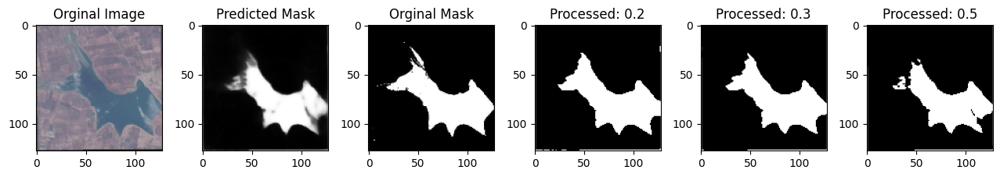

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7415 - loss: 0.2389 - val_accuracy: 0.7593 - val_loss: 0.2271
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7361 - loss: 0.25


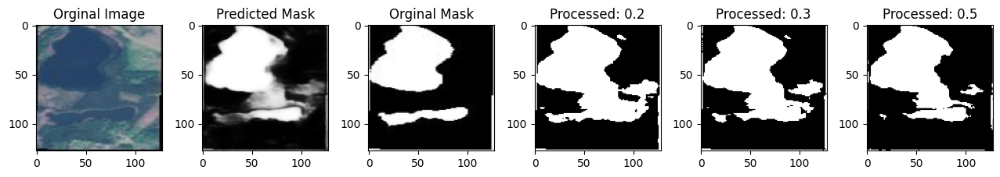

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7361 - loss: 0.2505 - val_accuracy: 0.7583 - val_loss: 0.2342
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7430 - loss: 0.24


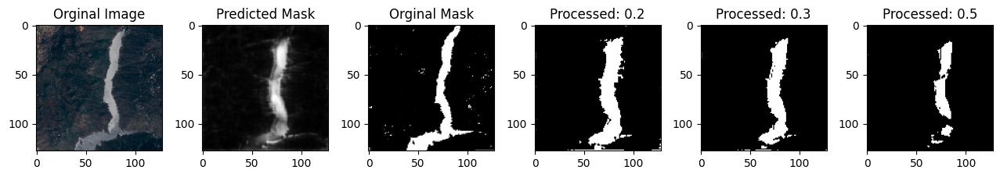

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7429 - loss: 0.2409 - val_accuracy: 0.7719 - val_loss: 0.2089
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7436 - loss: 0.23


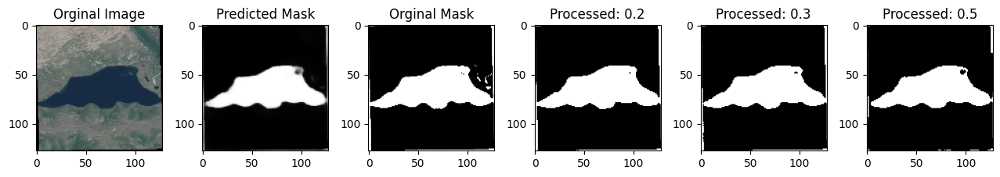

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7435 - loss: 0.2379 - val_accuracy: 0.7699 - val_loss: 0.2062
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7375 - loss: 0.23


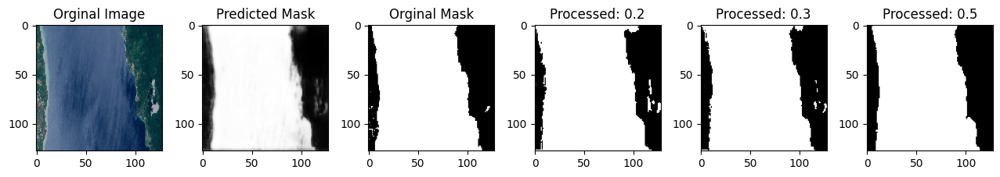

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7375 - loss: 0.2390 - val_accuracy: 0.7689 - val_loss: 0.2063
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7425 - loss: 0.23


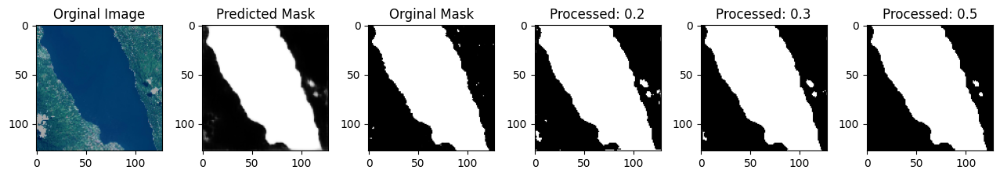

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7425 - loss: 0.2390 - val_accuracy: 0.7722 - val_loss: 0.2039
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7433 - loss: 0.23


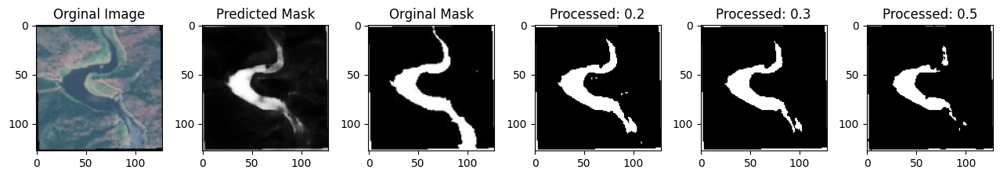

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7432 - loss: 0.2384 - val_accuracy: 0.7673 - val_loss: 0.2179
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7411 - loss: 0.24


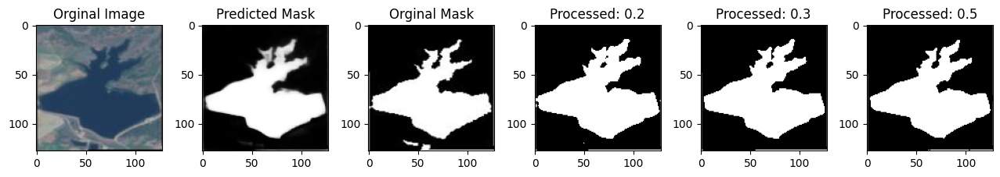

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7410 - loss: 0.2455 - val_accuracy: 0.7695 - val_loss: 0.2069
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/stepep - accuracy: 0.7410 - loss: 0.234


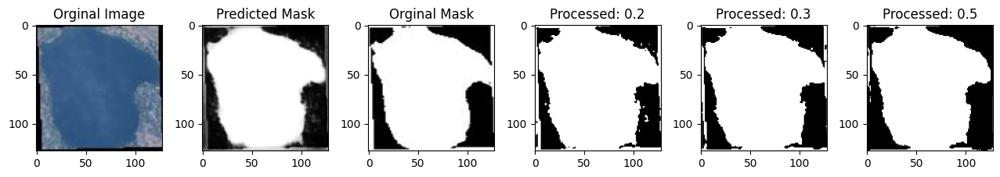

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7410 - loss: 0.2346 - val_accuracy: 0.7731 - val_loss: 0.1935
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7438 - loss: 0.23


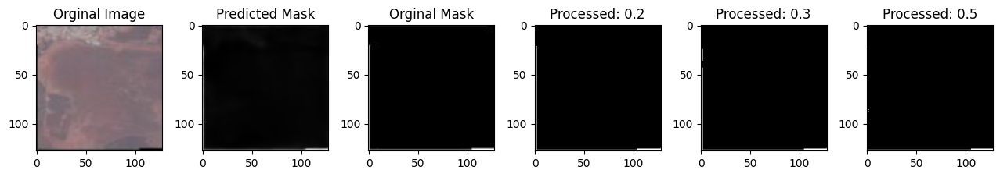

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7438 - loss: 0.2348 - val_accuracy: 0.7725 - val_loss: 0.2023
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7432 - loss: 0.22


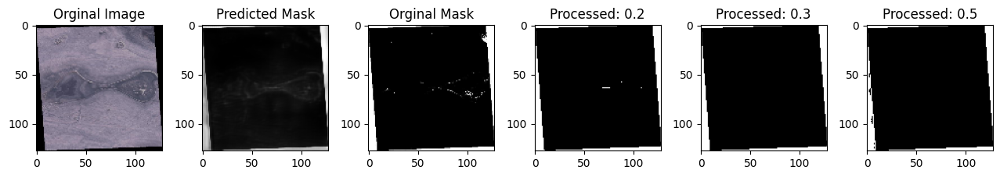

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7432 - loss: 0.2300 - val_accuracy: 0.7723 - val_loss: 0.2033
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7430 - loss: 0.22


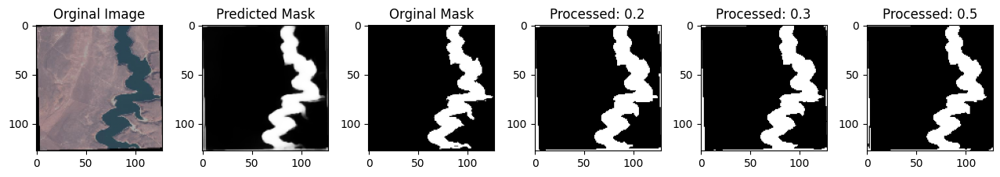

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7431 - loss: 0.2257 - val_accuracy: 0.7679 - val_loss: 0.2035
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7387 - loss: 0.23


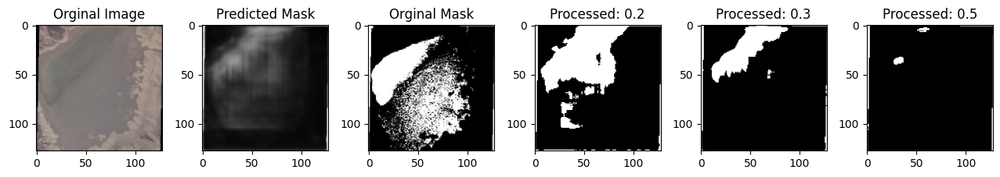

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7387 - loss: 0.2316 - val_accuracy: 0.7719 - val_loss: 0.2060
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7496 - loss: 0.22


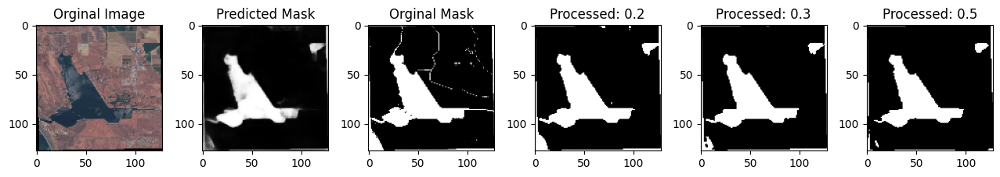

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7495 - loss: 0.2205 - val_accuracy: 0.7680 - val_loss: 0.2134
Epoch 53/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7513 - loss: 0.22


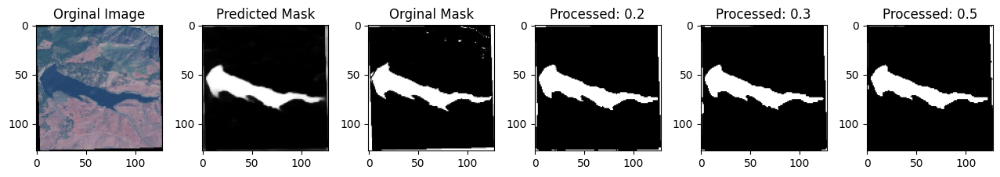

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7511 - loss: 0.2258 - val_accuracy: 0.7678 - val_loss: 0.2165
Epoch 54/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7474 - loss: 0.22


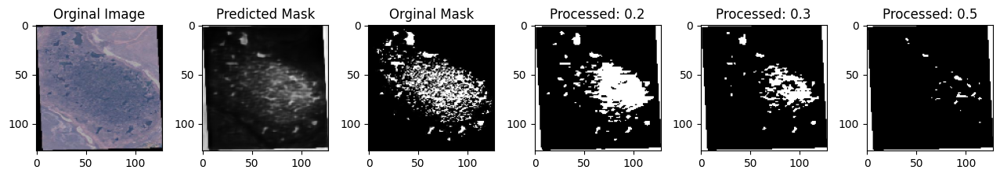

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7473 - loss: 0.2260 - val_accuracy: 0.7702 - val_loss: 0.2078
Epoch 55/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7449 - loss: 0.22


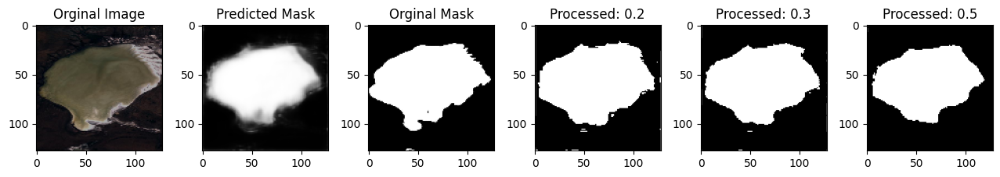

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7449 - loss: 0.2290 - val_accuracy: 0.7804 - val_loss: 0.2003
Epoch 56/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7442 - loss: 0.22


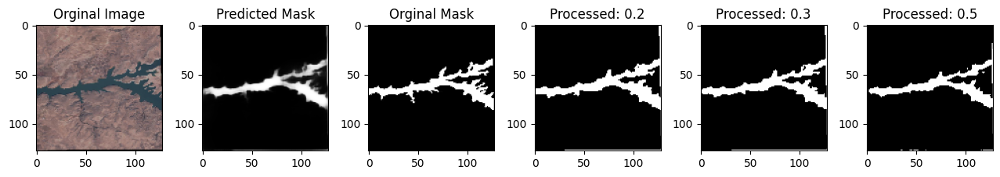

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7442 - loss: 0.2285 - val_accuracy: 0.7665 - val_loss: 0.2143
Epoch 57/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7514 - loss: 0.22


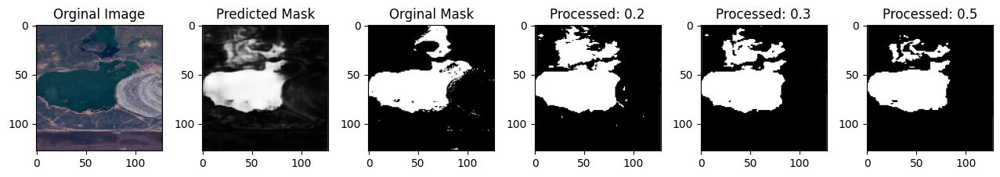

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7514 - loss: 0.2206 - val_accuracy: 0.7752 - val_loss: 0.1975
Epoch 58/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7573 - loss: 0.21


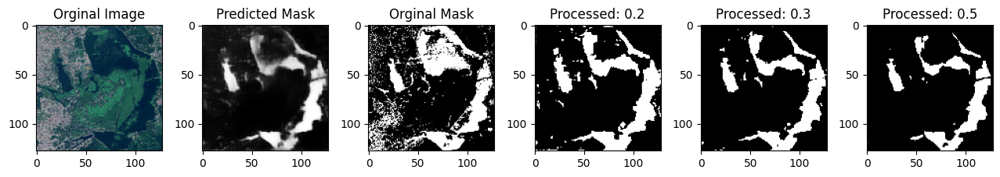

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7572 - loss: 0.2142 - val_accuracy: 0.7678 - val_loss: 0.2042
Epoch 59/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7478 - loss: 0.216


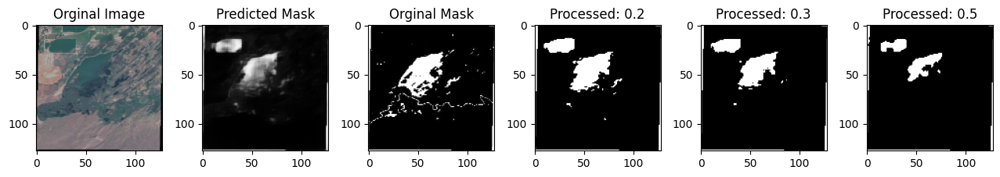

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7478 - loss: 0.2168 - val_accuracy: 0.7761 - val_loss: 0.1911
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7388 - loss: 0.22


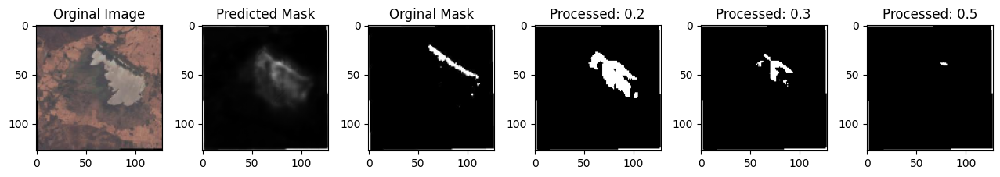

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7389 - loss: 0.2246 - val_accuracy: 0.7766 - val_loss: 0.1913
Epoch 61/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7405 - loss: 0.22


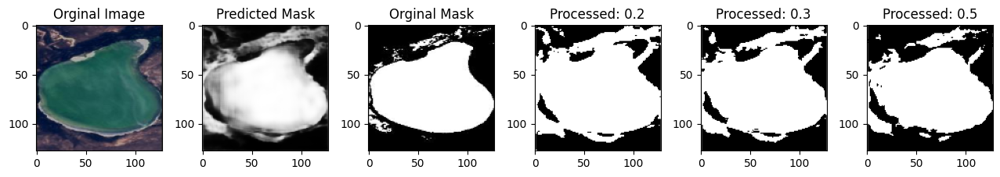

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7406 - loss: 0.2254 - val_accuracy: 0.7695 - val_loss: 0.2164
Epoch 62/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7485 - loss: 0.22


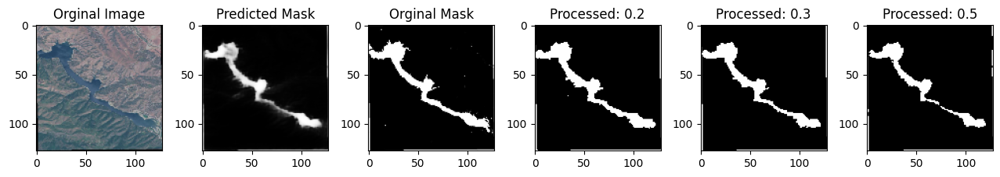

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7485 - loss: 0.2206 - val_accuracy: 0.7781 - val_loss: 0.1837
Epoch 63/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7494 - loss: 0.22


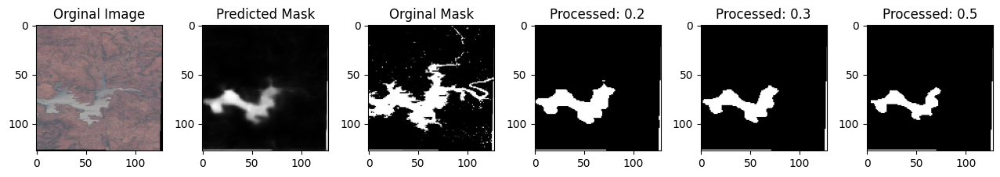

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7494 - loss: 0.2203 - val_accuracy: 0.7793 - val_loss: 0.1841
Epoch 64/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7452 - loss: 0.22


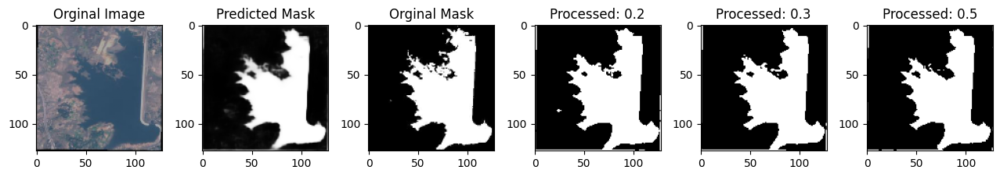

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7452 - loss: 0.2277 - val_accuracy: 0.7669 - val_loss: 0.2104
Epoch 65/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7509 - loss: 0.21


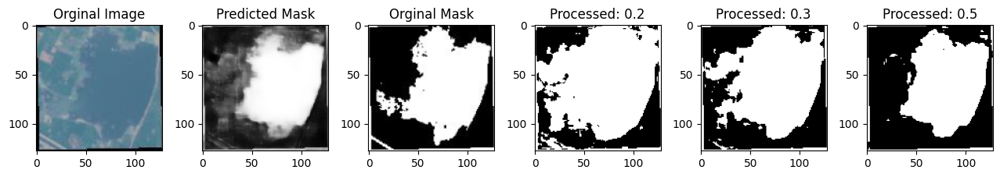

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7509 - loss: 0.2116 - val_accuracy: 0.7711 - val_loss: 0.1978
Epoch 66/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7524 - loss: 0.20


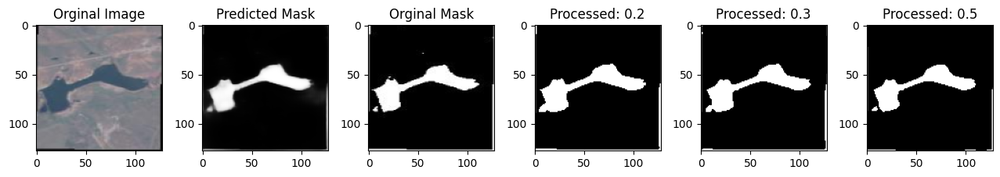

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7524 - loss: 0.2079 - val_accuracy: 0.7791 - val_loss: 0.1847
Epoch 67/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7506 - loss: 0.21


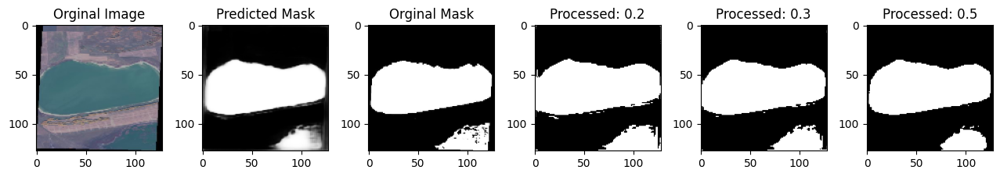

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7505 - loss: 0.2193 - val_accuracy: 0.7765 - val_loss: 0.1875
Epoch 68/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7485 - loss: 0.21


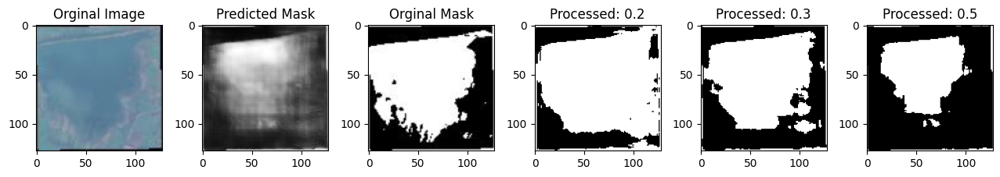

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7485 - loss: 0.2167 - val_accuracy: 0.7621 - val_loss: 0.2272
Epoch 69/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7410 - loss: 0.22


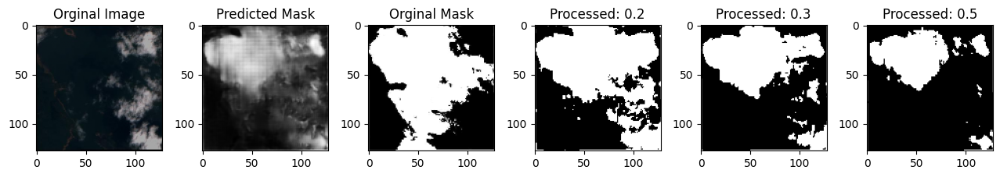

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7410 - loss: 0.2289 - val_accuracy: 0.7688 - val_loss: 0.2142
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7519 - loss: 0.21


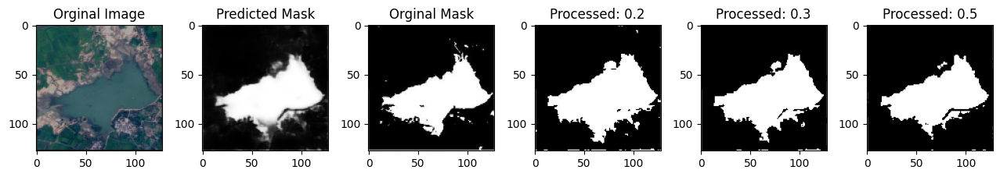

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7518 - loss: 0.2152 - val_accuracy: 0.7714 - val_loss: 0.2018
Epoch 71/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7498 - loss: 0.21


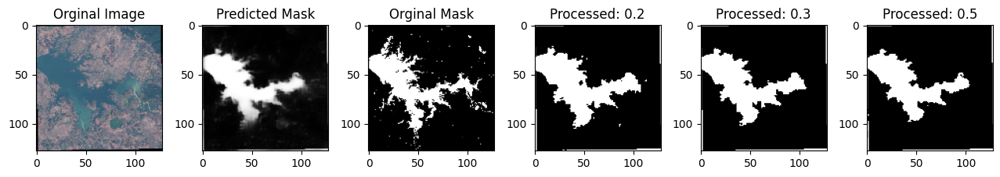

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7498 - loss: 0.2162 - val_accuracy: 0.7799 - val_loss: 0.1867
Epoch 72/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7558 - loss: 0.20


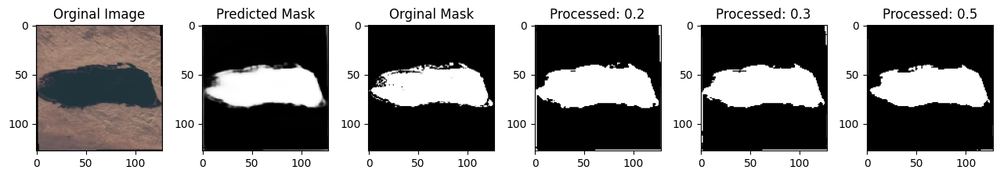

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7557 - loss: 0.2076 - val_accuracy: 0.7731 - val_loss: 0.1952
Epoch 73/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7436 - loss: 0.22


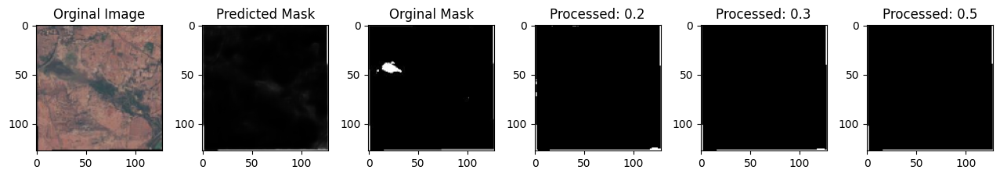

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7436 - loss: 0.2215 - val_accuracy: 0.7767 - val_loss: 0.1869
Epoch 74/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7495 - loss: 0.20


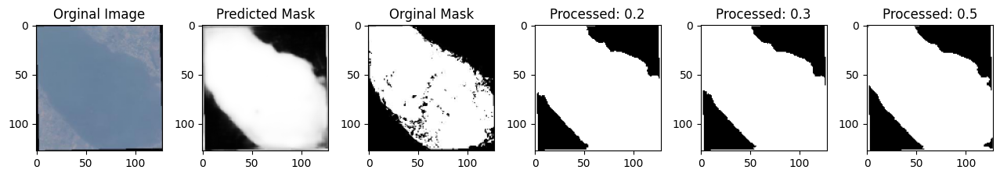

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7495 - loss: 0.2081 - val_accuracy: 0.7793 - val_loss: 0.1798
Epoch 75/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7483 - loss: 0.21


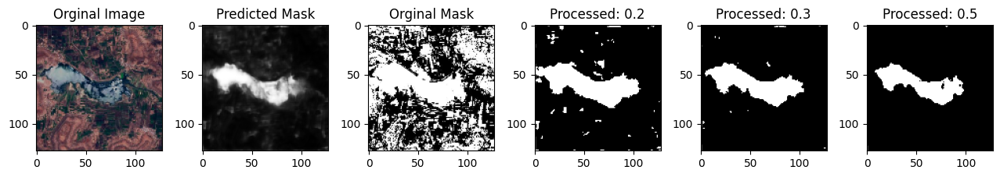

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7483 - loss: 0.2111 - val_accuracy: 0.7798 - val_loss: 0.1784
Epoch 76/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7474 - loss: 0.21


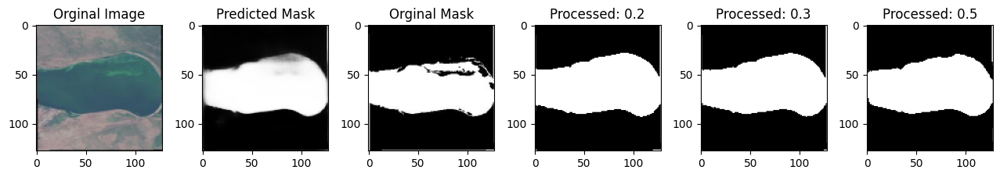

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7475 - loss: 0.2102 - val_accuracy: 0.7844 - val_loss: 0.1711
Epoch 77/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7542 - loss: 0.20


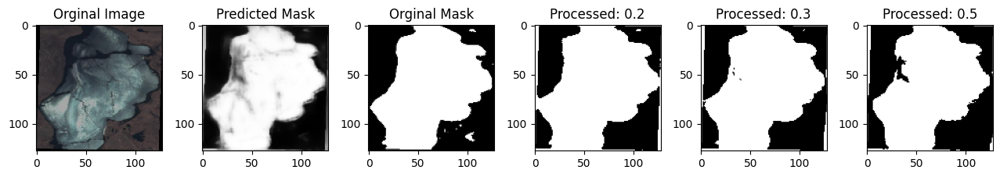

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7541 - loss: 0.2074 - val_accuracy: 0.7533 - val_loss: 0.2614
Epoch 78/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7490 - loss: 0.22


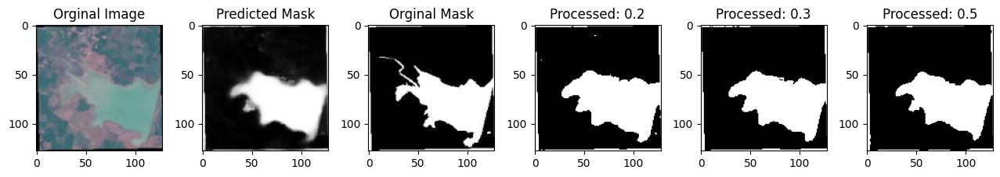

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7490 - loss: 0.2216 - val_accuracy: 0.7797 - val_loss: 0.1959
Epoch 79/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7559 - loss: 0.20


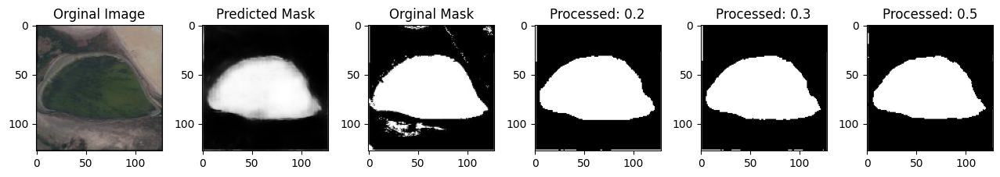

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7558 - loss: 0.2016 - val_accuracy: 0.7803 - val_loss: 0.1861
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7582 - loss: 0.20


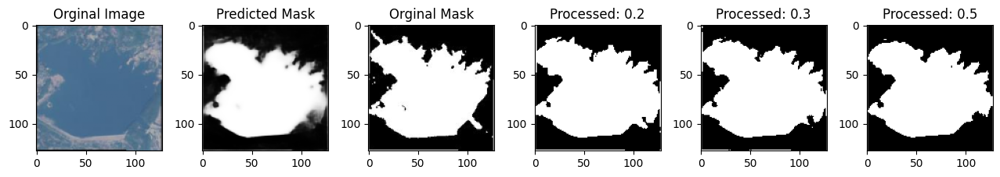

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7582 - loss: 0.2045 - val_accuracy: 0.7704 - val_loss: 0.2074
Epoch 81/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7511 - loss: 0.20


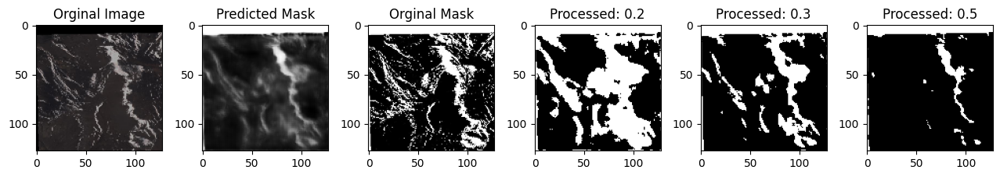

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7511 - loss: 0.2068 - val_accuracy: 0.7766 - val_loss: 0.1946
Epoch 82/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7507 - loss: 0.20


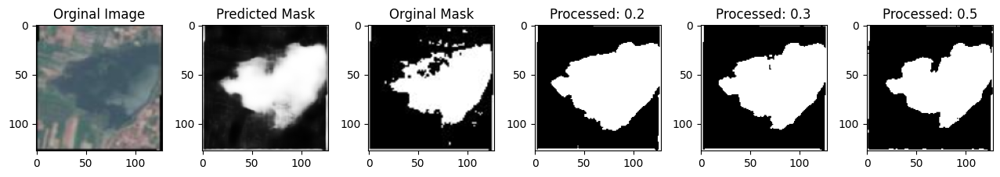

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7507 - loss: 0.2011 - val_accuracy: 0.7789 - val_loss: 0.1839
Epoch 83/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7500 - loss: 0.20


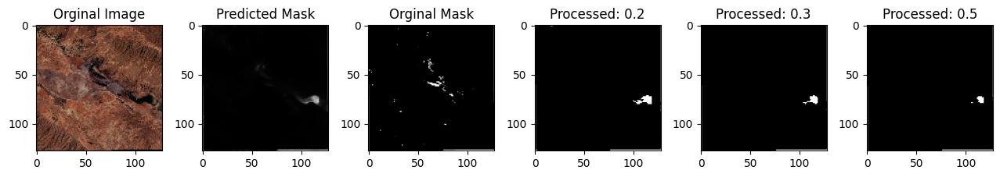

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7500 - loss: 0.2085 - val_accuracy: 0.7677 - val_loss: 0.2077
Epoch 84/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7485 - loss: 0.20


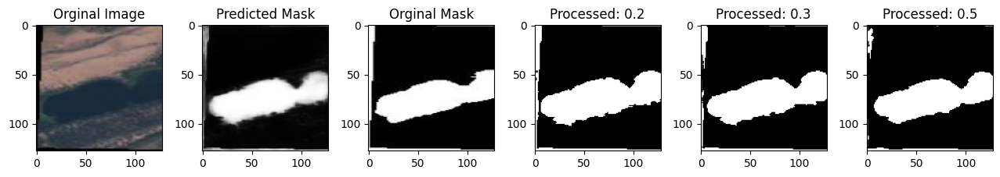

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7486 - loss: 0.2085 - val_accuracy: 0.7669 - val_loss: 0.2046
Epoch 85/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7478 - loss: 0.21


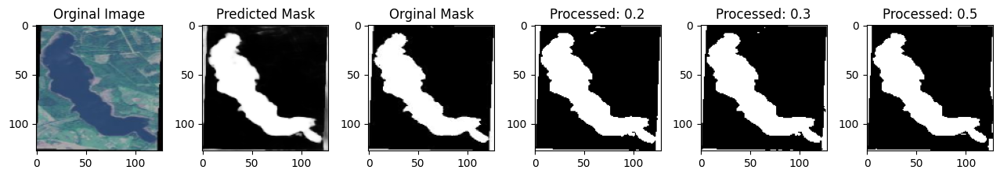

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7478 - loss: 0.2113 - val_accuracy: 0.7792 - val_loss: 0.1843
Epoch 86/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7534 - loss: 0.198


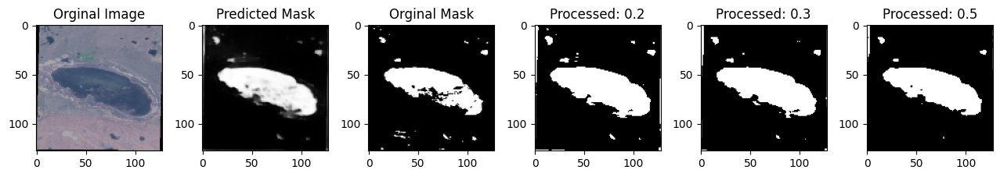

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7534 - loss: 0.1987 - val_accuracy: 0.7773 - val_loss: 0.1791
Epoch 87/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7536 - loss: 0.20


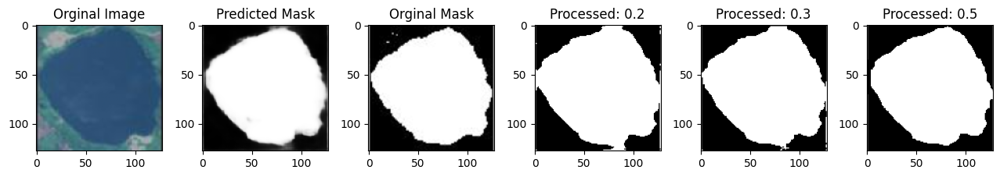

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7535 - loss: 0.2039 - val_accuracy: 0.7722 - val_loss: 0.1976
Epoch 88/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7526 - loss: 0.20


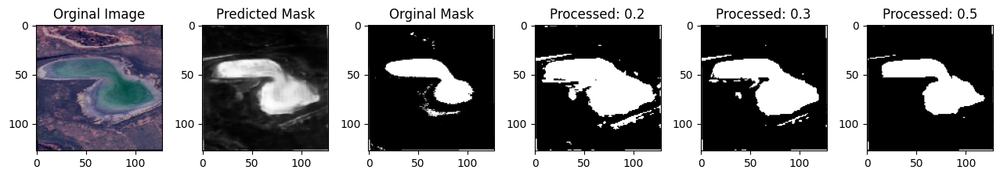

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7526 - loss: 0.2039 - val_accuracy: 0.7727 - val_loss: 0.1929
Epoch 89/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7456 - loss: 0.22


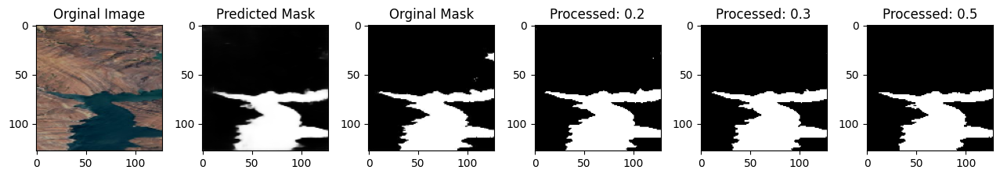

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7457 - loss: 0.2232 - val_accuracy: 0.7826 - val_loss: 0.1864
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7553 - loss: 0.19


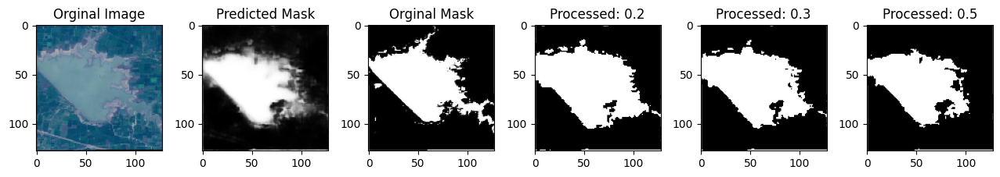

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7553 - loss: 0.1912 - val_accuracy: 0.7744 - val_loss: 0.1957
Epoch 91/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7562 - loss: 0.19


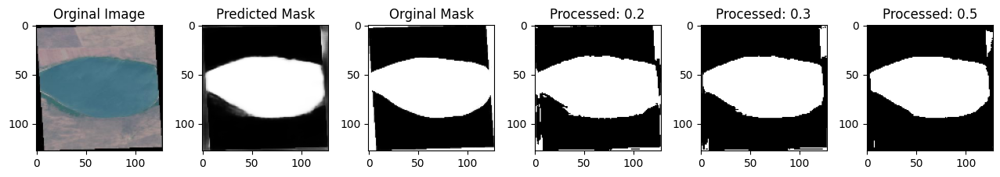

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7562 - loss: 0.1926 - val_accuracy: 0.7742 - val_loss: 0.1909
Epoch 92/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7523 - loss: 0.20


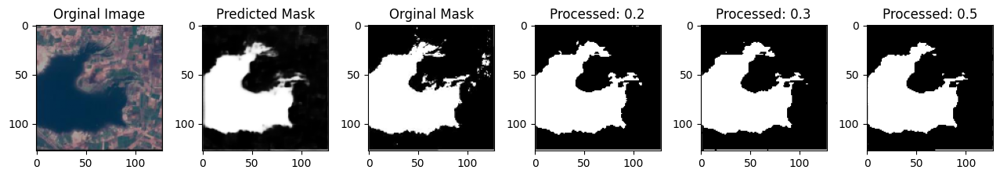

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7523 - loss: 0.2005 - val_accuracy: 0.7786 - val_loss: 0.1833
Epoch 93/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7554 - loss: 0.19


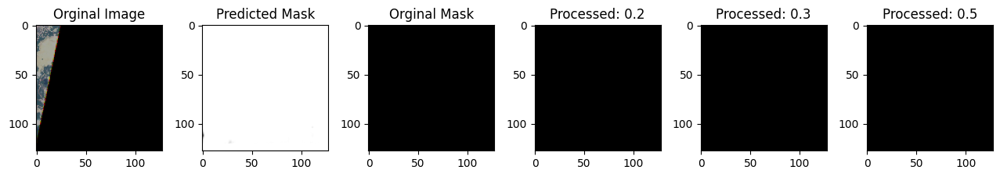

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7554 - loss: 0.1916 - val_accuracy: 0.7797 - val_loss: 0.1904
Epoch 94/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7521 - loss: 0.196


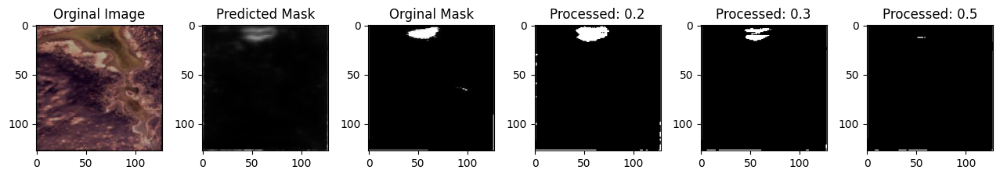

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7522 - loss: 0.1962 - val_accuracy: 0.7824 - val_loss: 0.1738
Epoch 95/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7558 - loss: 0.19


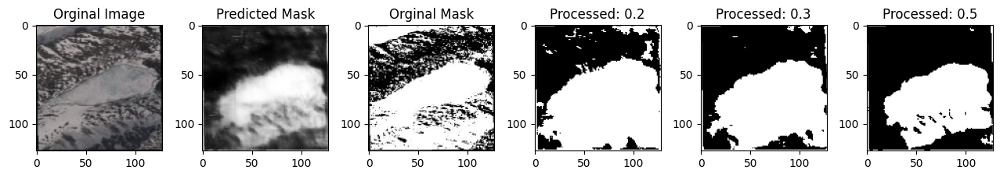

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7558 - loss: 0.1911 - val_accuracy: 0.7728 - val_loss: 0.2042
Epoch 96/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7579 - loss: 0.190


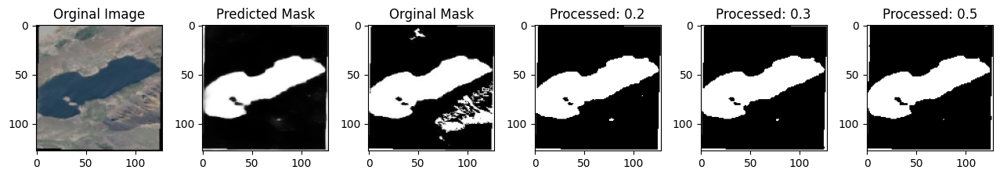

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7579 - loss: 0.1903 - val_accuracy: 0.7784 - val_loss: 0.1799
Epoch 97/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7584 - loss: 0.19


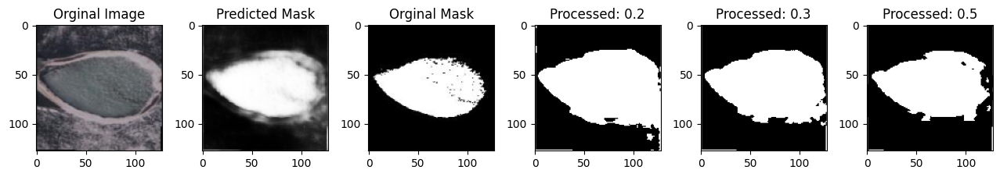

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7584 - loss: 0.1937 - val_accuracy: 0.7800 - val_loss: 0.1848
Epoch 98/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7589 - loss: 0.18


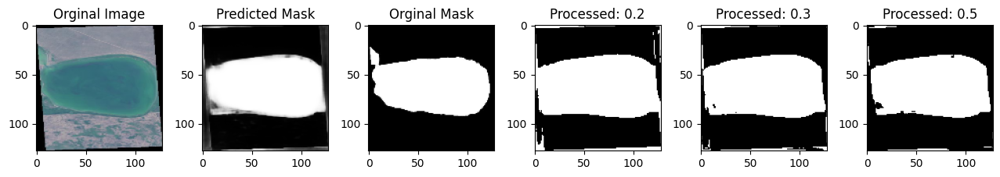

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7589 - loss: 0.1872 - val_accuracy: 0.7772 - val_loss: 0.1718
Epoch 99/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7546 - loss: 0.18


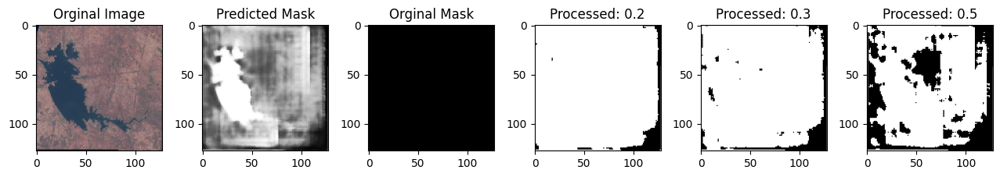

88/88 ━━━━━━━━━━━━━━━━━━━━ 3s 39ms/step - accuracy: 0.7547 - loss: 0.1860 - val_accuracy: 0.7797 - val_loss: 0.1908
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7562 - loss: 0.19


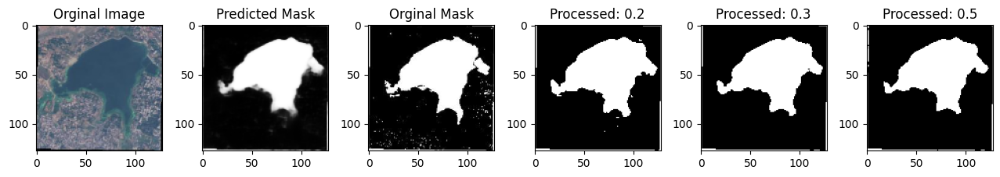

88/88 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.7561 - loss: 0.1944 - val_accuracy: 0.7806 - val_loss: 0.1893


In [12]:
# Training
epochs = 100
batch_size = 32

history = model.fit(images_train, mask_train,
                    validation_data=[images_test, mask_test], 
                    epochs=epochs,
                    callbacks=[ShowProgress()],
                    batch_size=batch_size)

In [13]:
model.save('models/11-15.keras') 

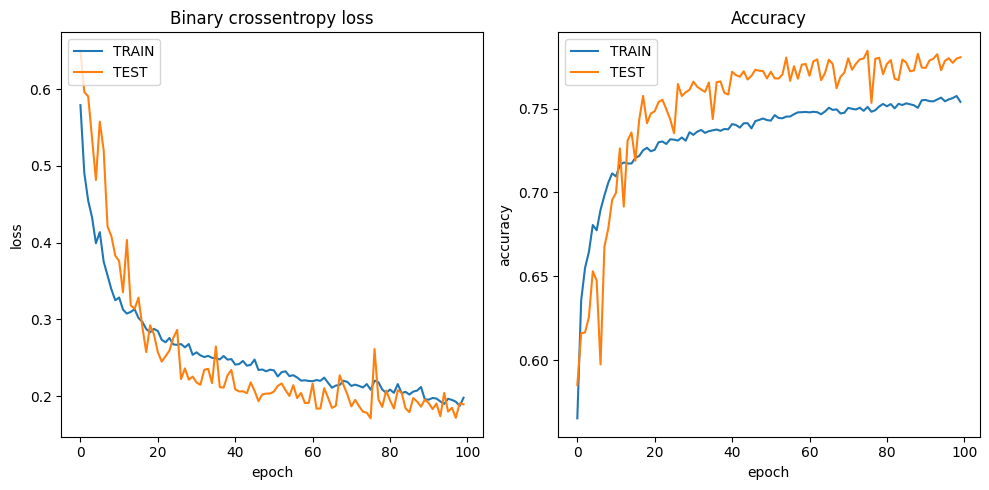

In [14]:
plt.figure(figsize=(10,5))

# Plot loss for each epoch
plt.subplot(1,2,1)
plt.plot(history.history['loss'], label="Train loss")
plt.plot(history.history['val_loss'], label="Test loss")
plt.title('Binary crossentropy loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

# Plot accuracy for each epoch
plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label="Train accuracy")
plt.plot(history.history['val_accuracy'], label="Test accuracy")
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

plt.tight_layout()
plt.show()

In [15]:
# Make predictions
predictions = model.predict(images_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


In [17]:
def plot_results(threshold=0.5):
    k = np.random.randint(len(images_test))
    original_image = images_test[k]
    mask = mask_test[k].reshape(128,128)
    predicted_mask = predictions[k].reshape(128,128)
    threshold_mask = mask_threshold(predicted_mask, threshold=threshold)

    plt.figure(figsize=(15,5))

    plt.subplot(1,4,1)
    plt.imshow(original_image);plt.title('Orginal Image')

    plt.subplot(1,4,2)
    plt.imshow(mask, cmap='gray');plt.title('Original Mask')

    plt.subplot(1,4,3)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,4,4)
    plt.imshow(threshold_mask, cmap='gray');plt.title(f'Predicted Mask with cutoff={threshold}')

    plt.tight_layout()
    plt.show()

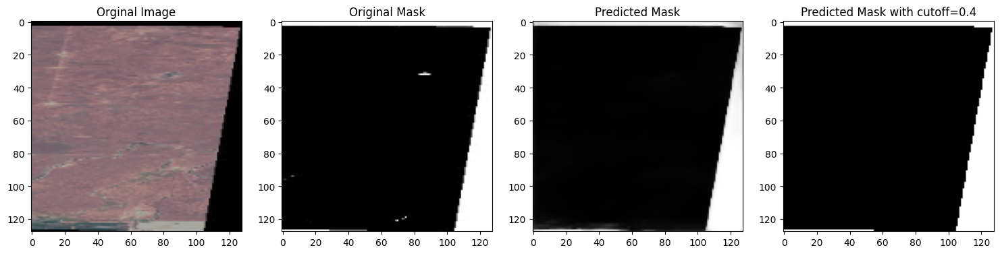

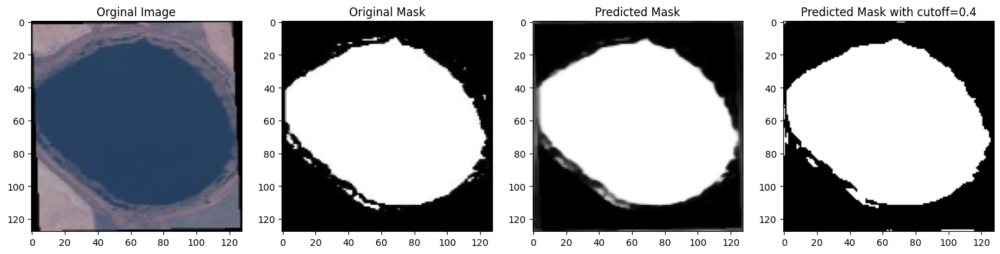

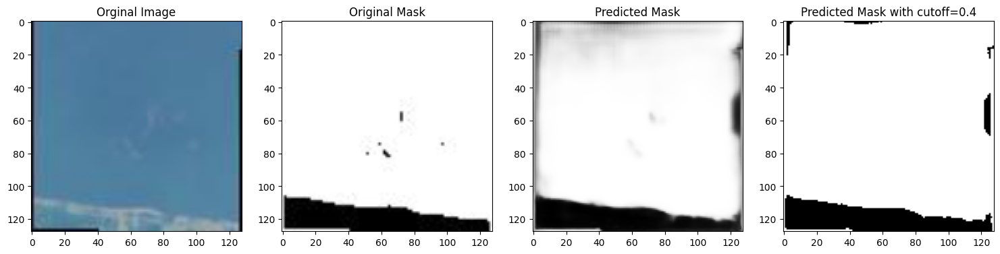

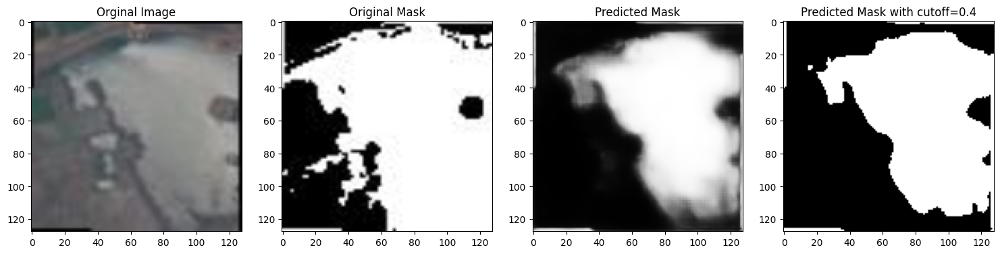

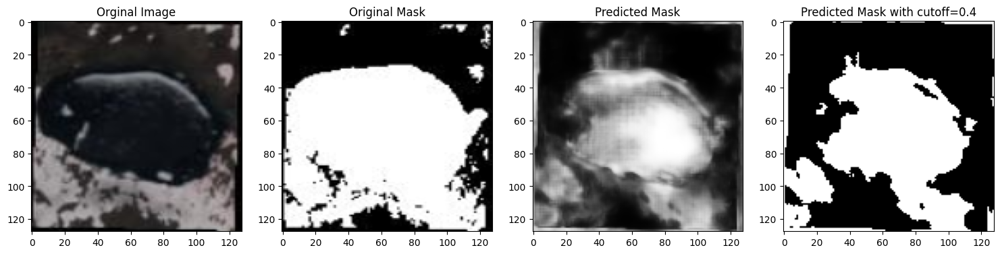

...

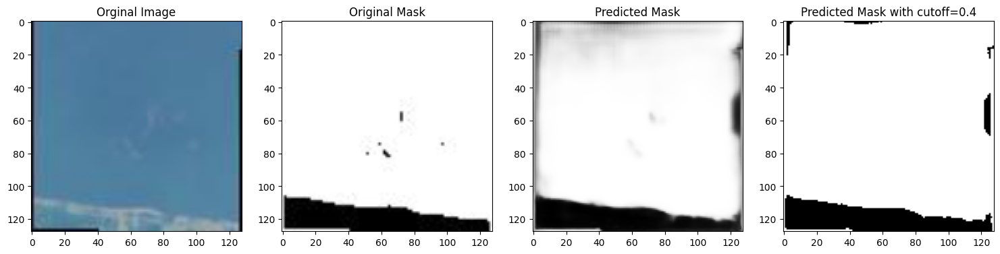

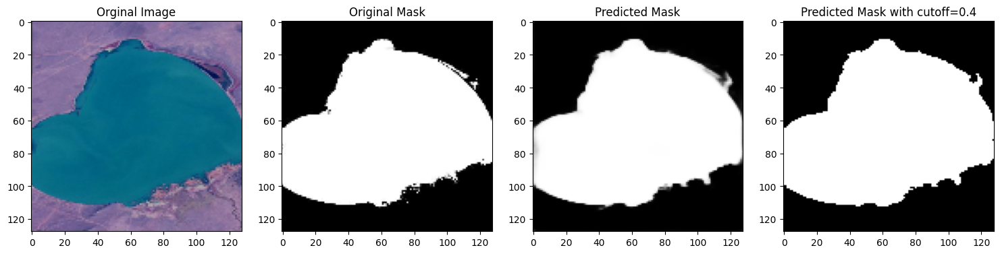

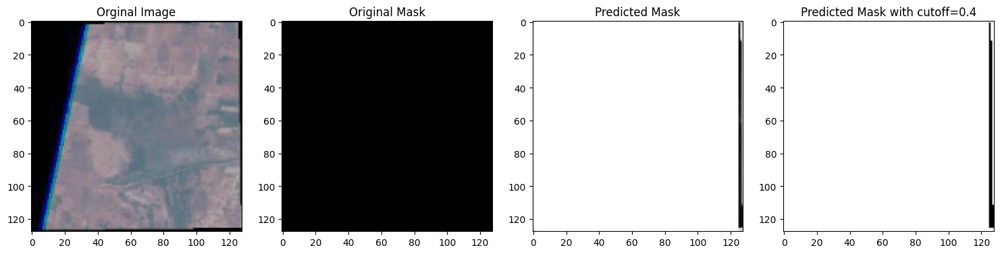

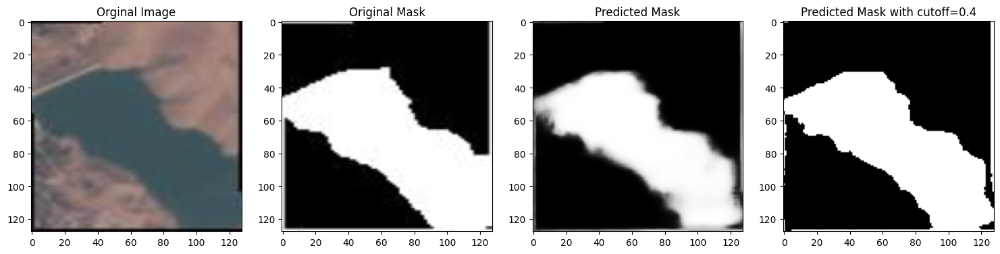

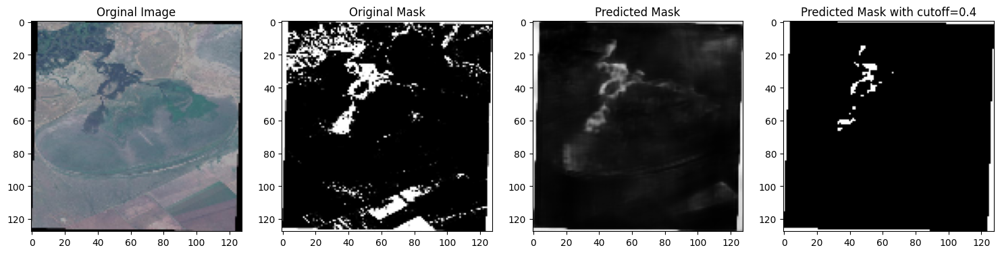

In [18]:
# Plot results on test data
for i in range(40):
  plot_results(threshold=0.4)